In [1]:
#require tensorflow version
# Same as EQpolarity env
# conda create -n eqp python=3.11.7
# conda activate eqp
# conda install ipython notebook
# pip install matplotlib==3.8.0 tensorflow==2.14.0 scikit-learn==1.2.2 seaborn==0.13.2 
#
# Or, on machine with a GPU setup, use the following commands
# 
# conda create -n eqp python=3.10.14
# conda activate eqp
# conda install ipython notebook
# pip install matplotlib==3.8.0 tensorflow==2.11.0 scikit-learn==1.2.2 seaborn==0.13.2 
# conda install -c anaconda cudnn==8.2.1

from matplotlib import pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import Input, Dense, Dropout, concatenate, UpSampling1D, Flatten, MaxPooling1D, BatchNormalization, average,Convolution2D,MaxPooling2D,UpSampling2D,Conv1D,LeakyReLU,add
from tensorflow.keras.models import Model
import time
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau,LearningRateScheduler
import scipy.io
import numpy as np
from tensorflow.keras import backend as K

from pyseistr import plot3d, cseis


def huber_loss_mean(y_true, y_pred, clip_delta=1.3):
    error = y_true - y_pred
    abs_error = tf.keras.backend.abs(error)

    squared_loss = 0.5 * tf.keras.backend.square(error)
    linear_loss = clip_delta * (abs_error - 0.5 * clip_delta)

    return tf.keras.backend.mean(tf.where(abs_error < clip_delta, squared_loss, linear_loss))

# This part is really tricky (when training, comment the below; when plotting the weights, uncomment the below and comment the below below)
import tensorflow  as tf
tf.compat.v1.enable_eager_execution()

# This part is really tricky (when training, uncomment the below; when plotting the weights, comment the below and uncomment the above)
# import tensorflow.compat.v1 as tf
# tf.disable_v2_behavior()

In [2]:
### load well-trained model
# model = load_model('best_model_3dfield.h5',custom_objects={'huber_loss_mean':huber_loss_mean})
# In another DEMO notebook, this file was trained
model = load_model('best_model_3dfield_new.h5',custom_objects={'huber_loss_mean': huber_loss_mean})
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 1728)]               0         []                            
                                                                                                  
 dense (Dense)               (None, 64)                   110656    ['input_1[0][0]']             
                                                                                                  
 dense_1 (Dense)             (None, 64)                   110656    ['input_1[0][0]']             
                                                                                                  
 leaky_re_lu (LeakyReLU)     (None, 64)                   0         ['dense[0][0]']               
                                                                                              

In [3]:
help(model)

Help on Functional in module keras.src.engine.functional object:

class Functional(keras.src.engine.training.Model)
 |  Functional(inputs, outputs, name=None, trainable=True, **kwargs)
 |  
 |  A `Functional` model is a `Model` defined as a directed graph of layers.
 |  
 |  Three types of `Model` exist: subclassed `Model`, `Functional` model,
 |  and `Sequential` (a special case of `Functional`).
 |  In general, more Keras features are supported with `Functional`
 |  than with subclassed `Model`s, specifically:
 |  
 |  - Model cloning (`keras.models.clone`)
 |  - Serialization (`model.get_config()/from_config`, `model.to_json()`
 |  - Whole-model saving (`model.save()`)
 |  
 |  A `Functional` model can be instantiated by passing two arguments to
 |  `__init__`. The first argument is the `keras.Input` Tensors that represent
 |  the inputs to the model. The second argument specifies the output
 |  tensors that represent the outputs of this model. Both arguments can be a
 |  nested str

In [4]:
model.get_weight_paths()

{'dense.kernel': <tf.Variable 'dense/kernel:0' shape=(1728, 64) dtype=float32, numpy=
 array([[ 0.00616702,  0.01232678, -0.02804011, ..., -0.13941923,
          0.03187551, -0.01107961],
        [-0.05709385,  0.03483782,  0.03097012, ..., -0.12083958,
          0.07384268,  0.02999935],
        [ 0.02769385, -0.04721205,  0.08381815, ..., -0.10540127,
         -0.02919051,  0.00959955],
        ...,
        [-0.01294717,  0.04726327,  0.1078136 , ..., -0.04755011,
         -0.06207789, -0.01048772],
        [-0.06637453, -0.01011073,  0.02245822, ..., -0.09082303,
         -0.02084437, -0.13193247],
        [-0.01084942,  0.03039985, -0.01574698, ..., -0.01549953,
          0.06241637, -0.04273312]], dtype=float32)>,
 'dense.bias': <tf.Variable 'dense/bias:0' shape=(64,) dtype=float32, numpy=
 array([ 1.2845659 ,  0.70474094,  0.6176667 , -0.31358573,  1.0149822 ,
        -0.21727136, -0.43637544,  0.5532949 , -0.21188986,  1.1067821 ,
         1.2600096 ,  1.0661564 ,  0.9722811 ,  

In [5]:
model.trainable_variables[0].shape

TensorShape([1728, 64])

In [6]:
model.trainable_variables[1].shape

TensorShape([64])

In [7]:
12*12*12

1728

In [8]:

W1=model.trainable_variables[0].numpy()
b1=model.trainable_variables[1].numpy()

/opt/anaconda3/envs/eqp/lib/python3.11/site-packages/pyseistr/plot.py:160: UserWarning: The following kwargs were not used by contour: 'barlabel'
  _ = ax.contourf(
/opt/anaconda3/envs/eqp/lib/python3.11/site-packages/pyseistr/plot.py:165: UserWarning: The following kwargs were not used by contour: 'barlabel'
  _ = ax.contourf(
/opt/anaconda3/envs/eqp/lib/python3.11/site-packages/pyseistr/plot.py:170: UserWarning: The following kwargs were not used by contour: 'barlabel'
  C = ax.contourf(


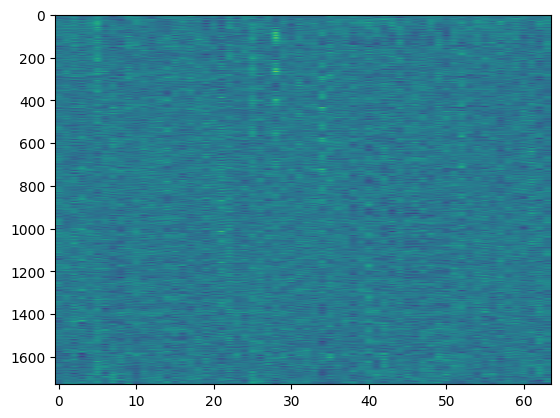

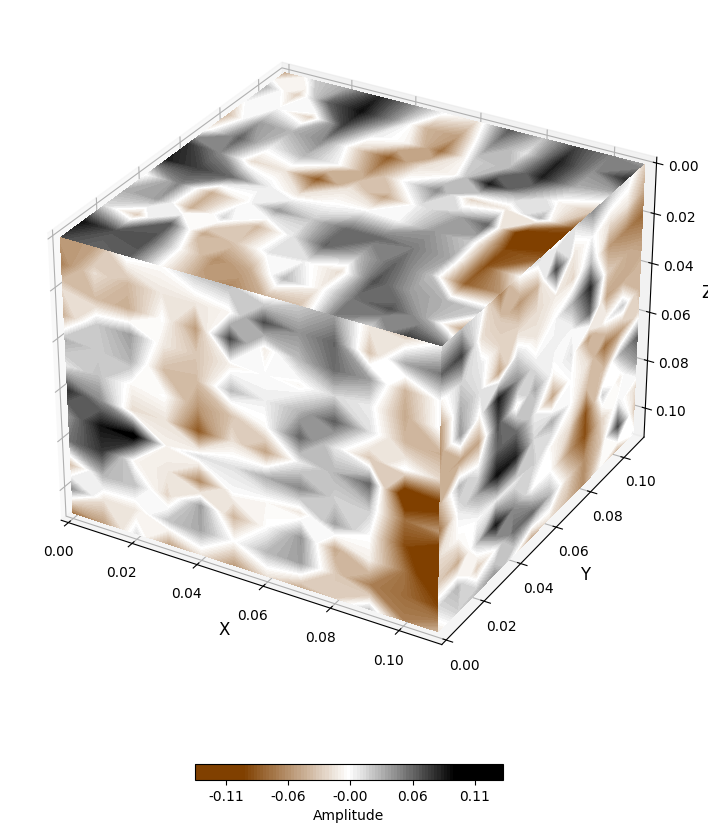

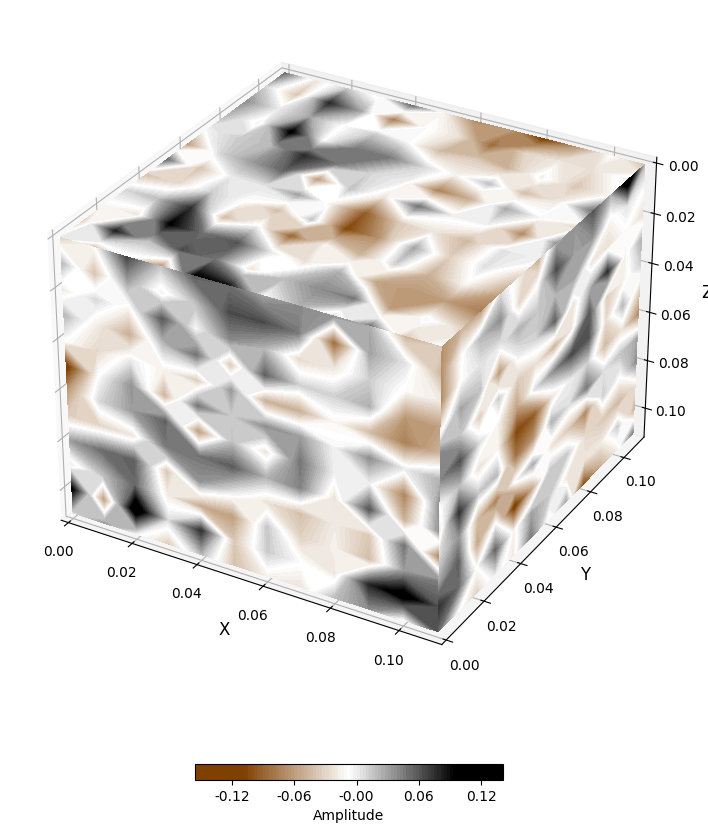

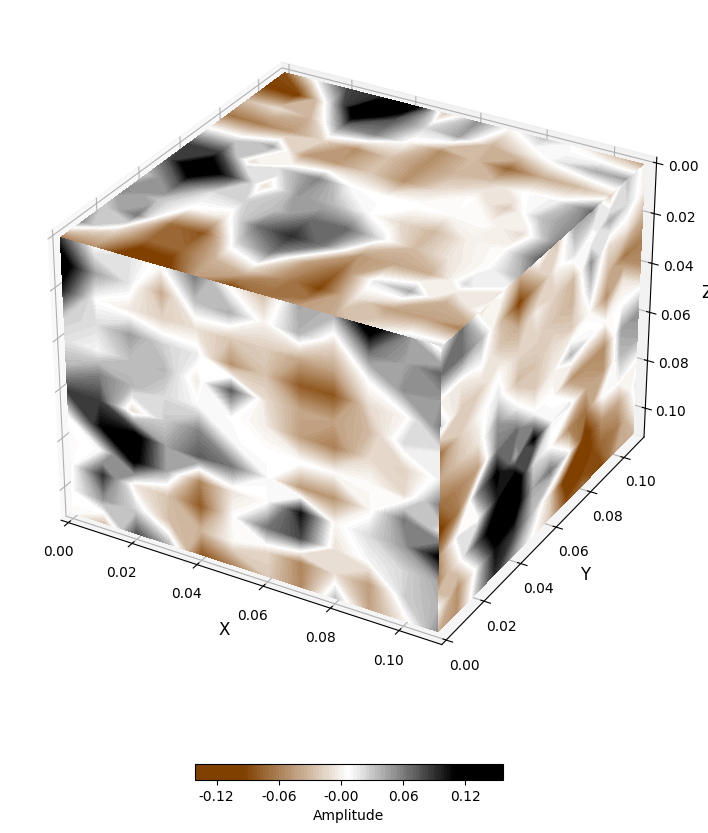

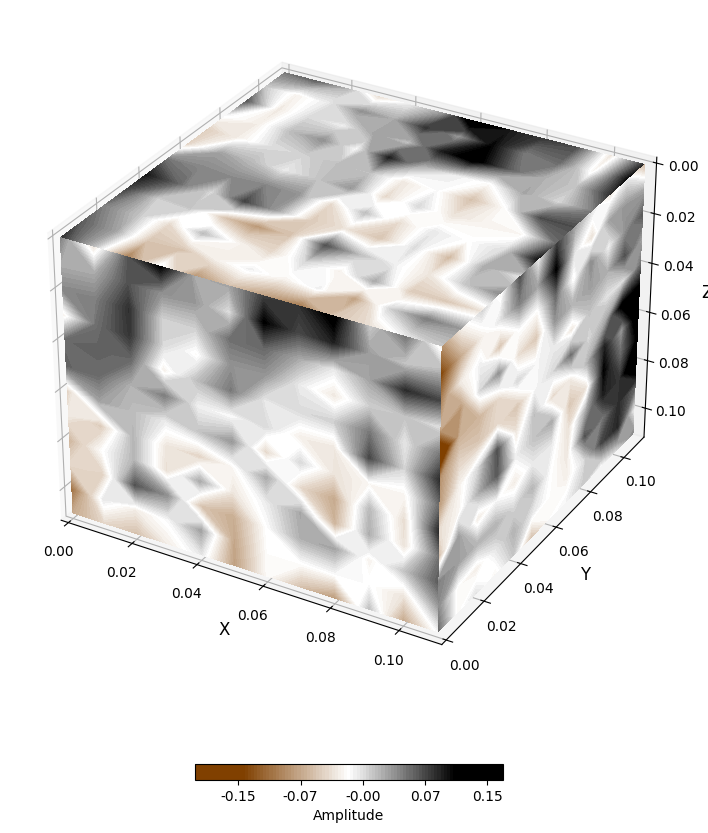

...

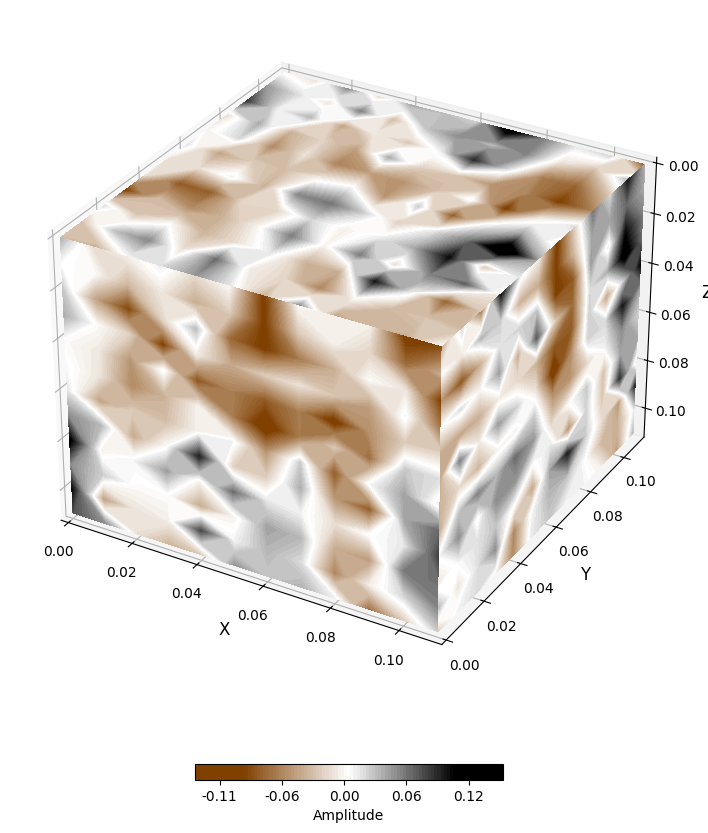

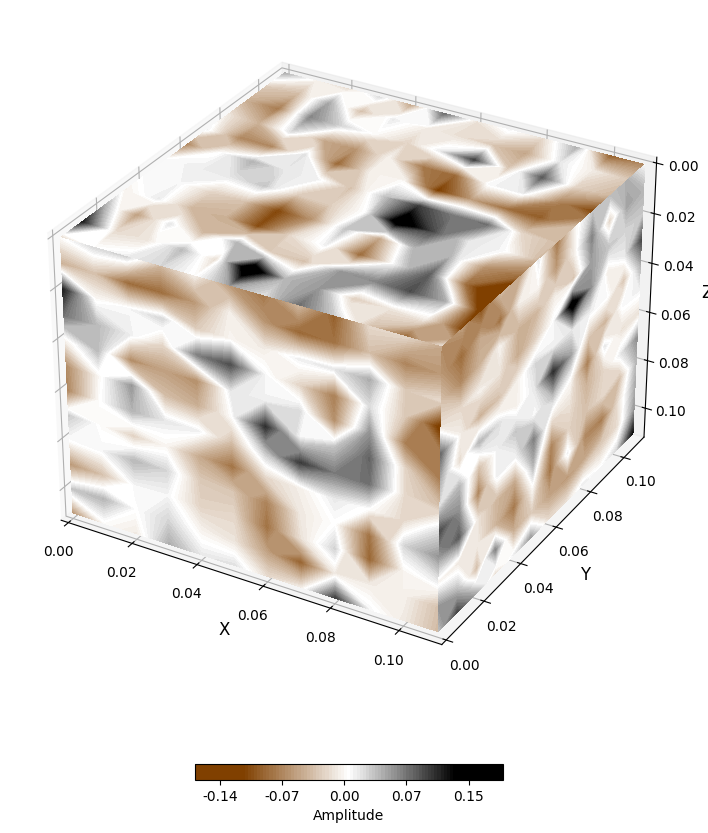

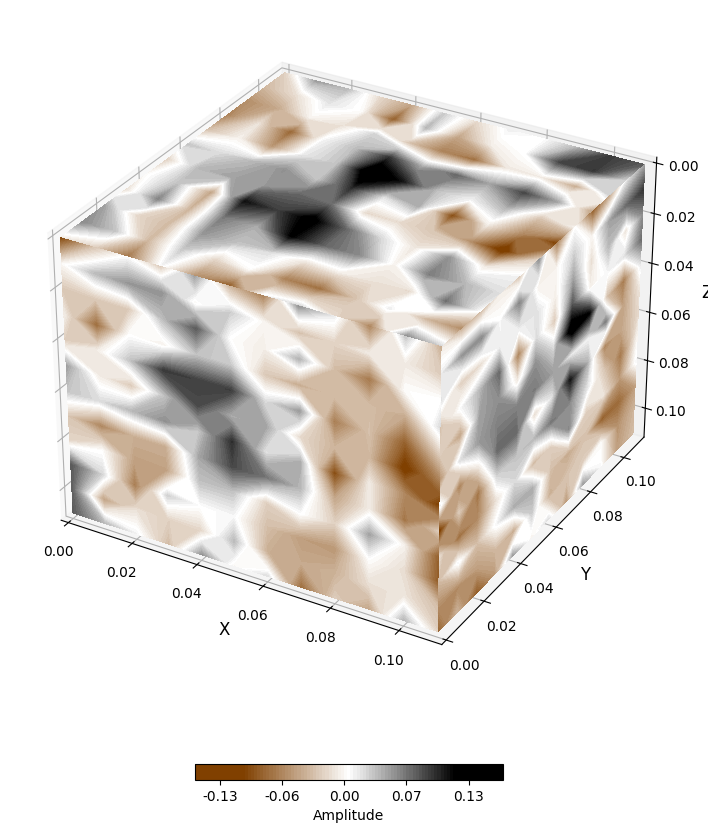

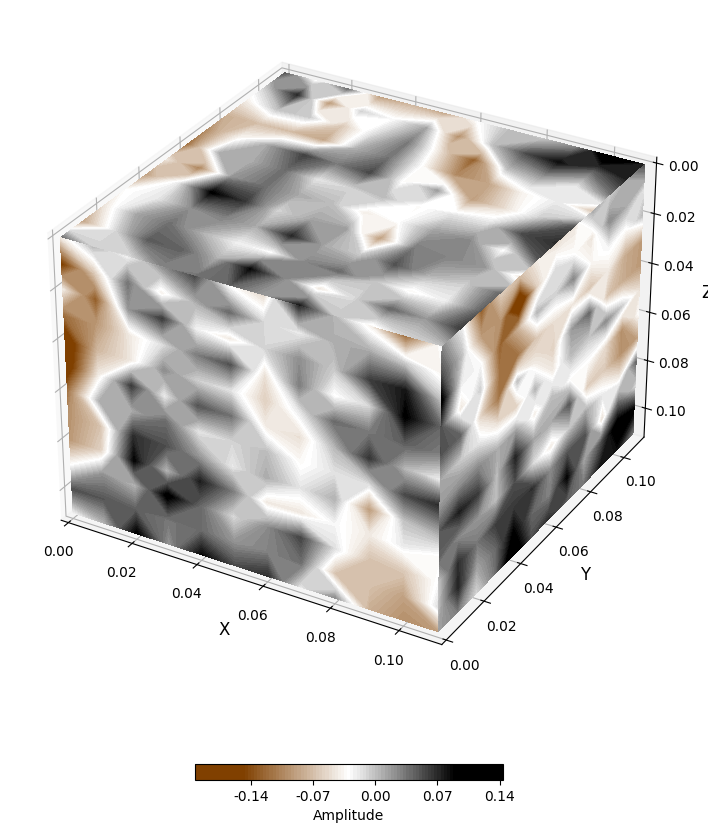

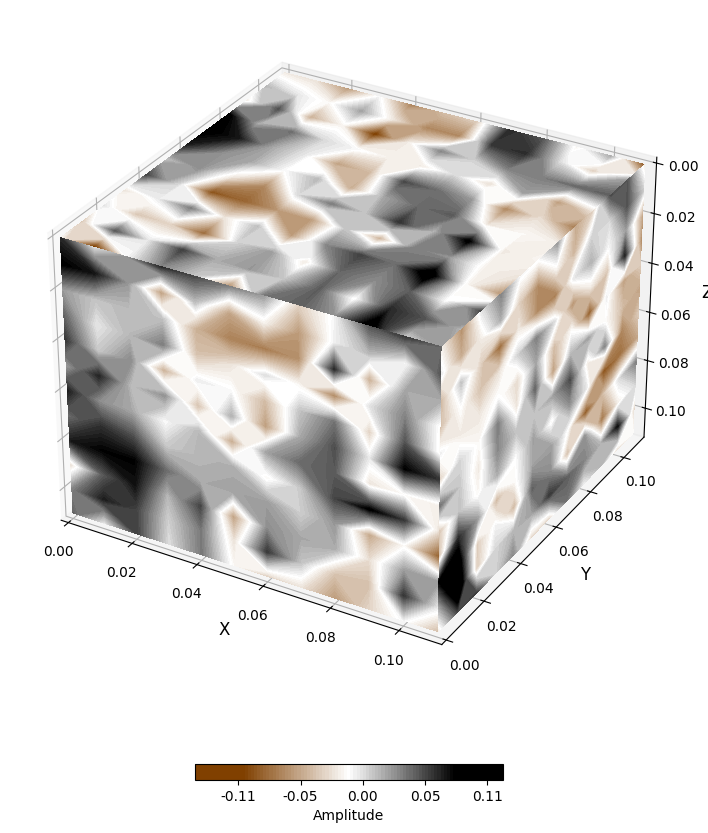

In [9]:
W1.shape
plt.imshow(W1,aspect='auto');

for ii in range(64):
    data=W1[:,ii].reshape(12,12,12)
    plot3d(data,figsize=(16,10),cmap=cseis(),barlabel='Amplitude',showf=True,close=False)



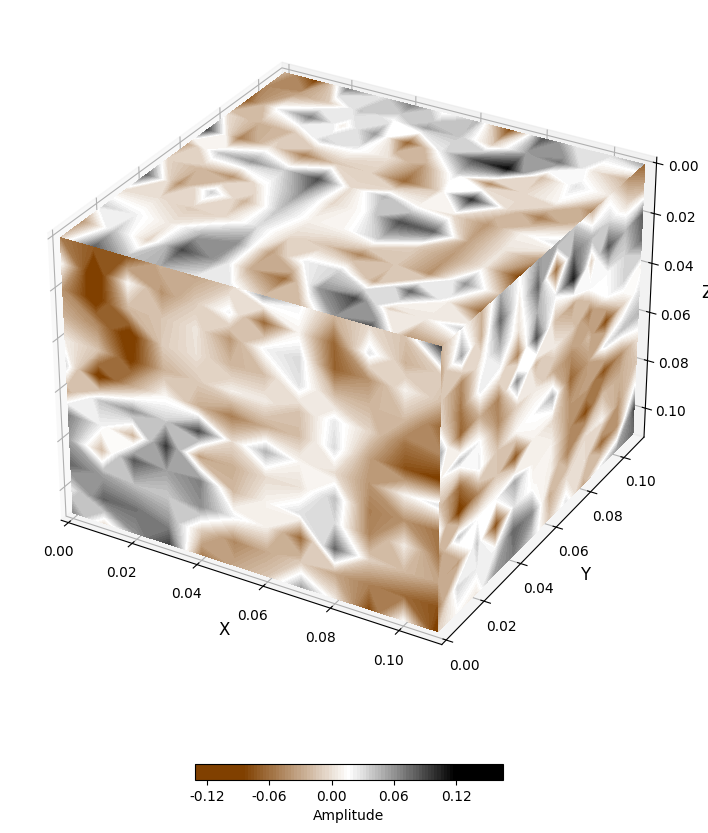

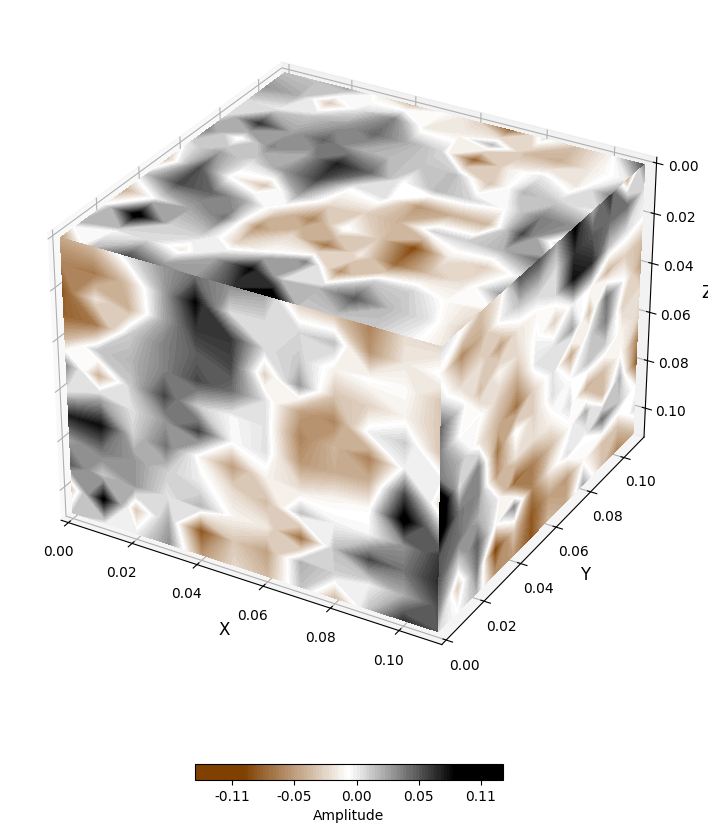

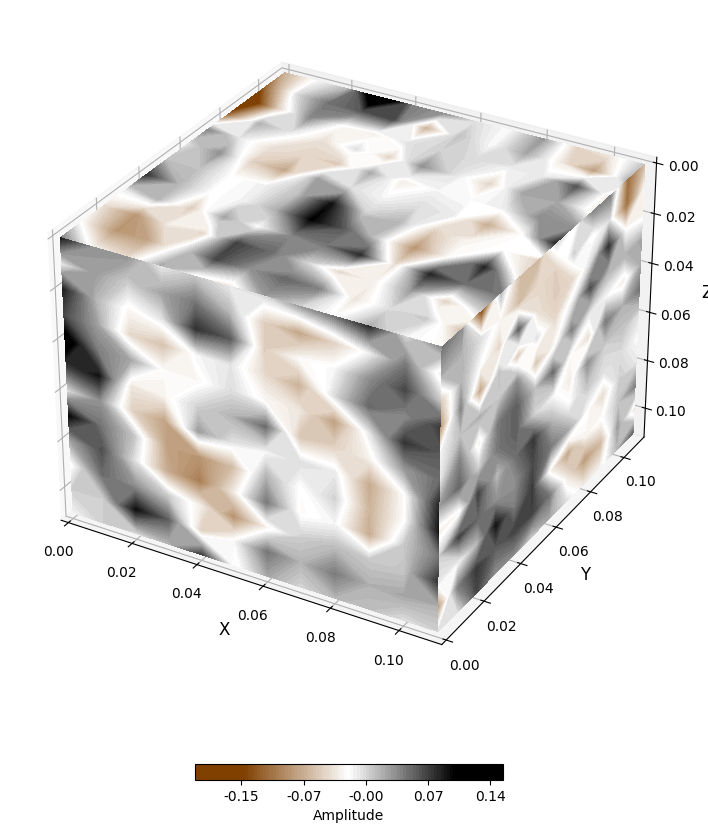

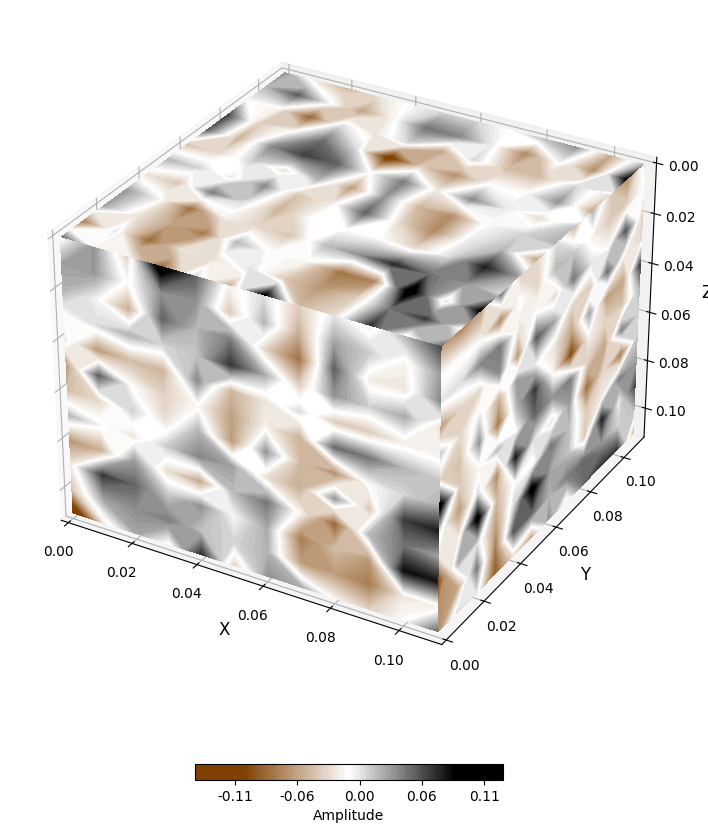

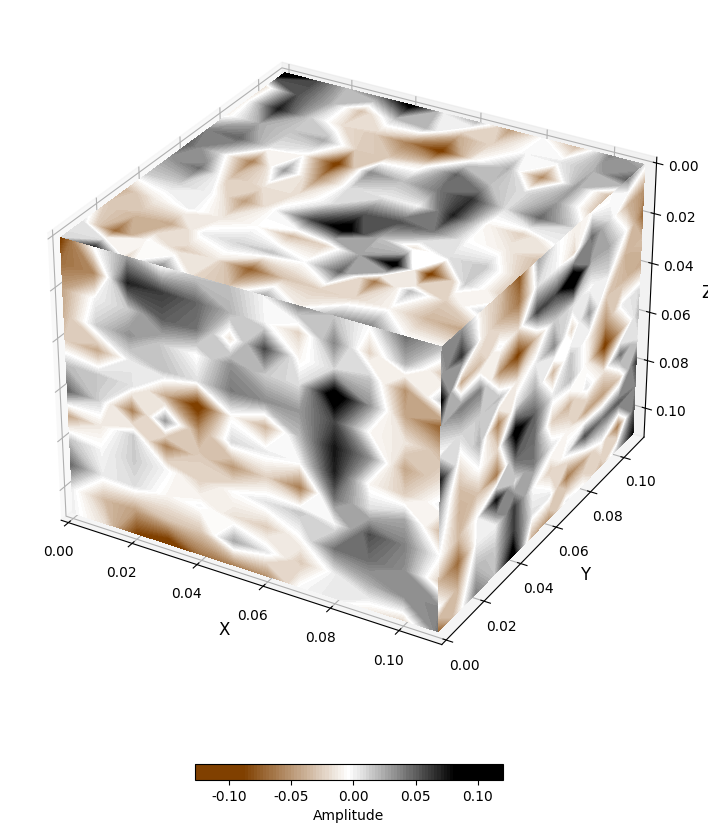

...

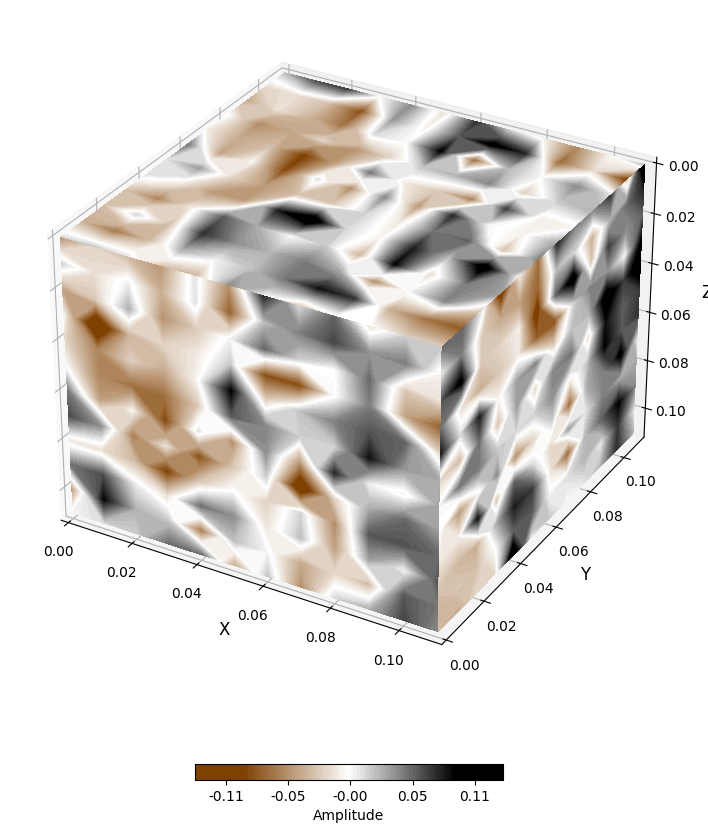

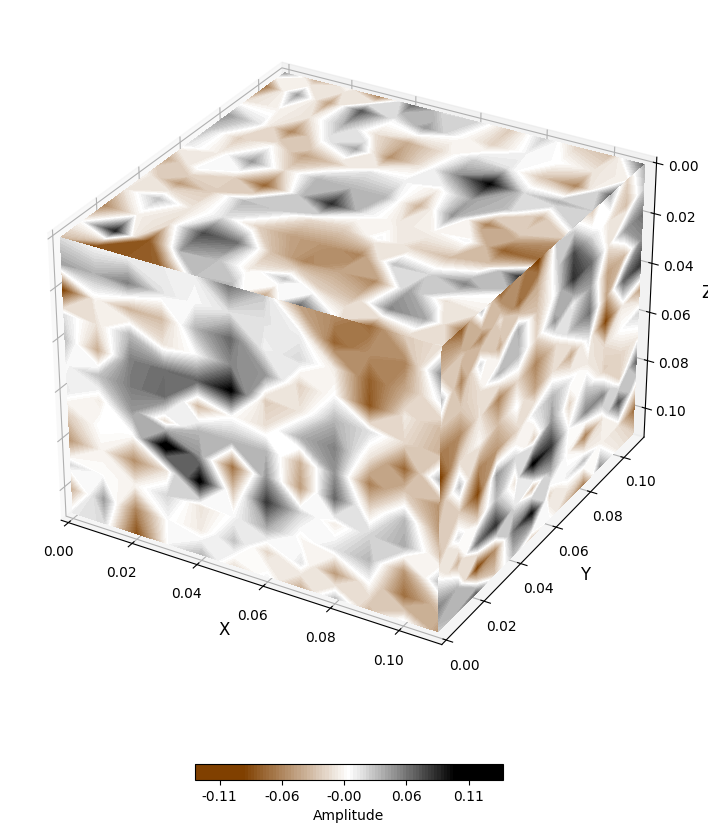

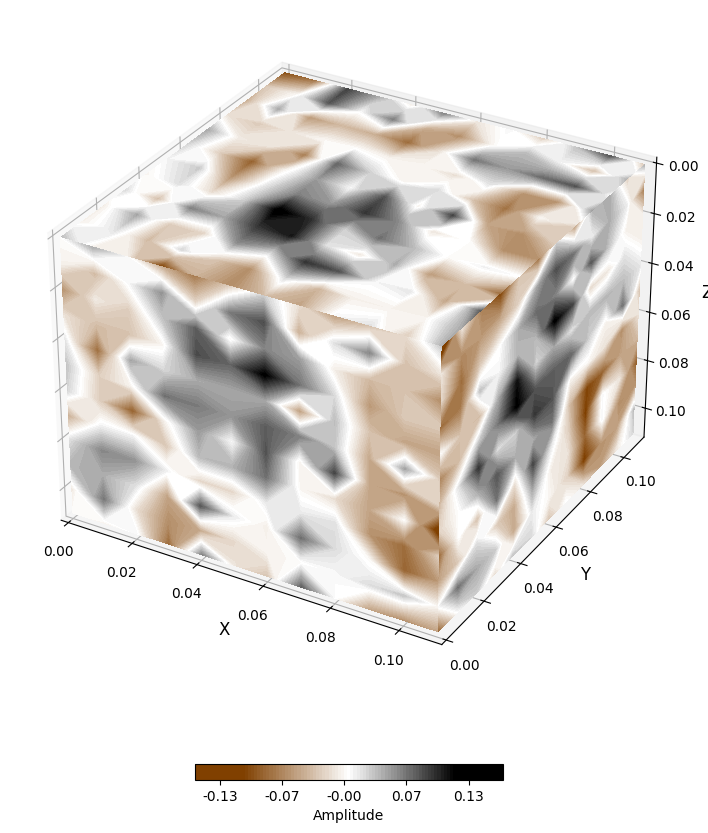

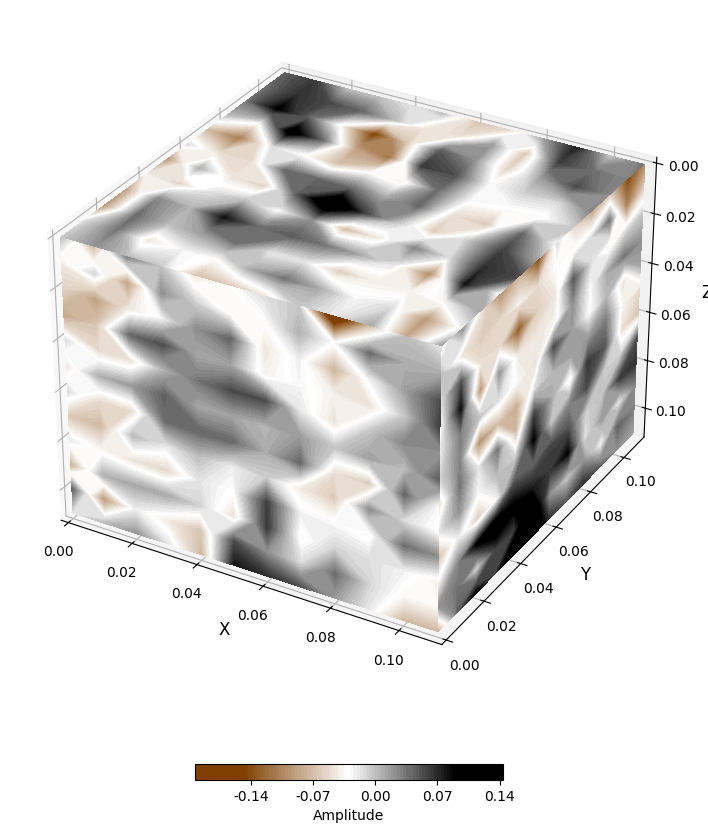

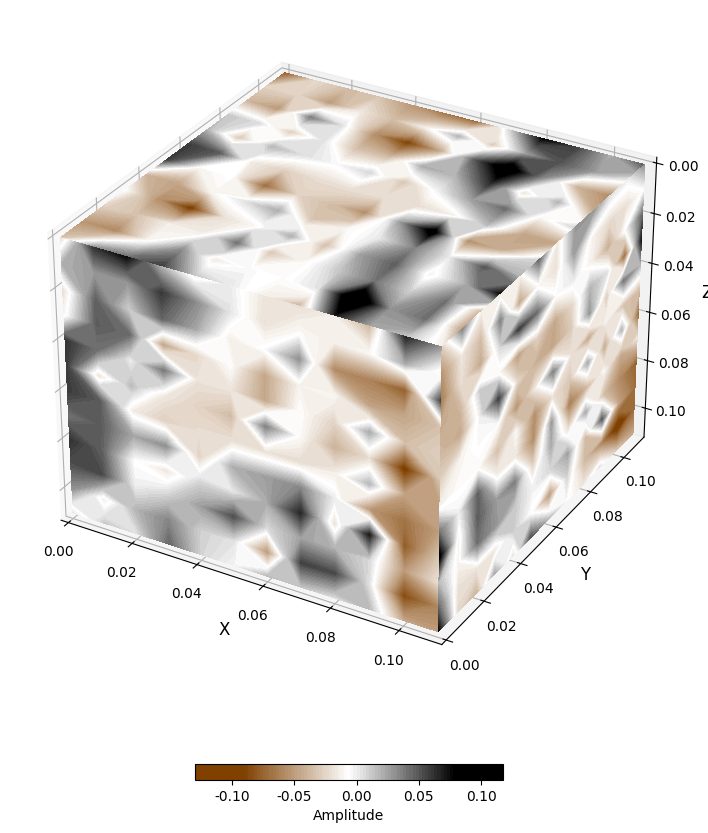

In [10]:
W11=model.trainable_variables[2].numpy()
b11=model.trainable_variables[3].numpy()

for ii in range(64):
    data=W11[:,ii].reshape(12,12,12)
    plot3d(data,figsize=(16,10),cmap=cseis(),barlabel='Amplitude',showf=True,close=False)


In [11]:
model.trainable_variables[-1]



<tf.Variable 'dense_26/bias:0' shape=(1728,) dtype=float32, numpy=
array([0.00430149, 0.00451228, 0.00549473, ..., 0.00067272, 0.00019874,
       0.00036697], dtype=float32)>

In [12]:
model.trainable_variables[-2]

<tf.Variable 'dense_26/kernel:0' shape=(128, 1728) dtype=float32, numpy=
array([[-0.02265705, -0.0240795 , -0.01993905, ..., -0.03041914,
        -0.02975067, -0.03241639],
       [ 0.00688422,  0.00798096,  0.00790392, ...,  0.00801846,
         0.00790625,  0.00924346],
       [ 0.01014743,  0.00519555,  0.00501284, ...,  0.00275681,
         0.00220362,  0.00695131],
       ...,
       [-0.02952512, -0.02712635, -0.01895271, ..., -0.03278244,
        -0.03139161, -0.03142388],
       [-0.01393743, -0.01169089, -0.00858108, ..., -0.00834682,
        -0.00653597, -0.00301781],
       [ 0.01741275,  0.01855982,  0.01884348, ..., -0.02532683,
        -0.02749344, -0.02389565]], dtype=float32)>

In [13]:
b2=model.trainable_variables[-1].numpy()
W2=model.trainable_variables[-2].numpy()



In [14]:
W2.shape

(128, 1728)

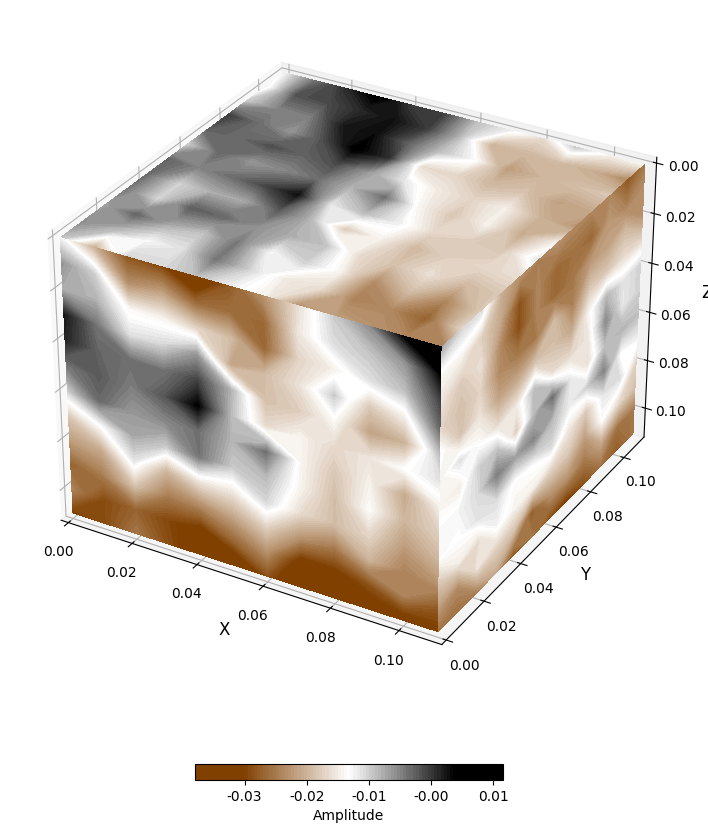

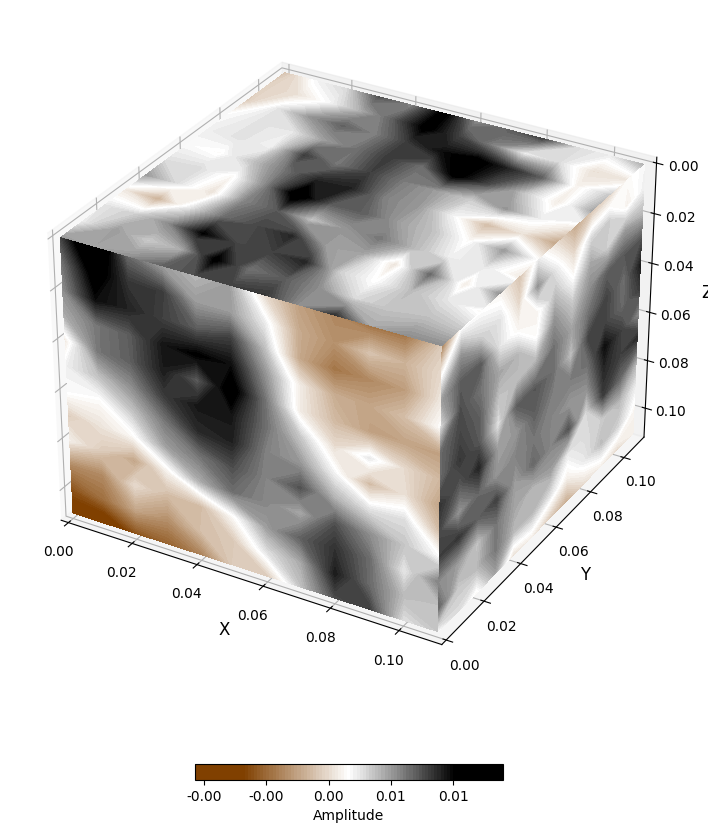

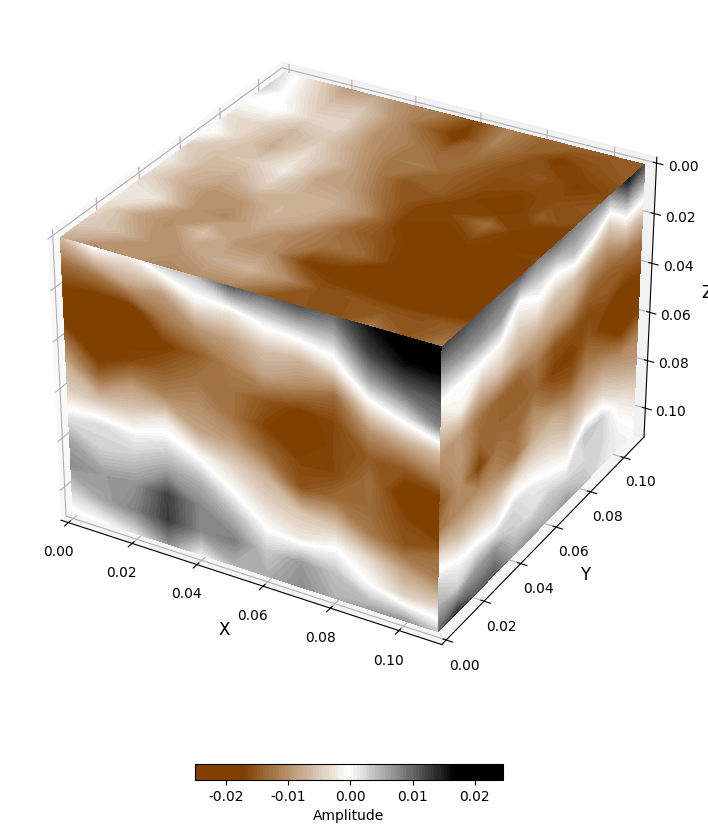

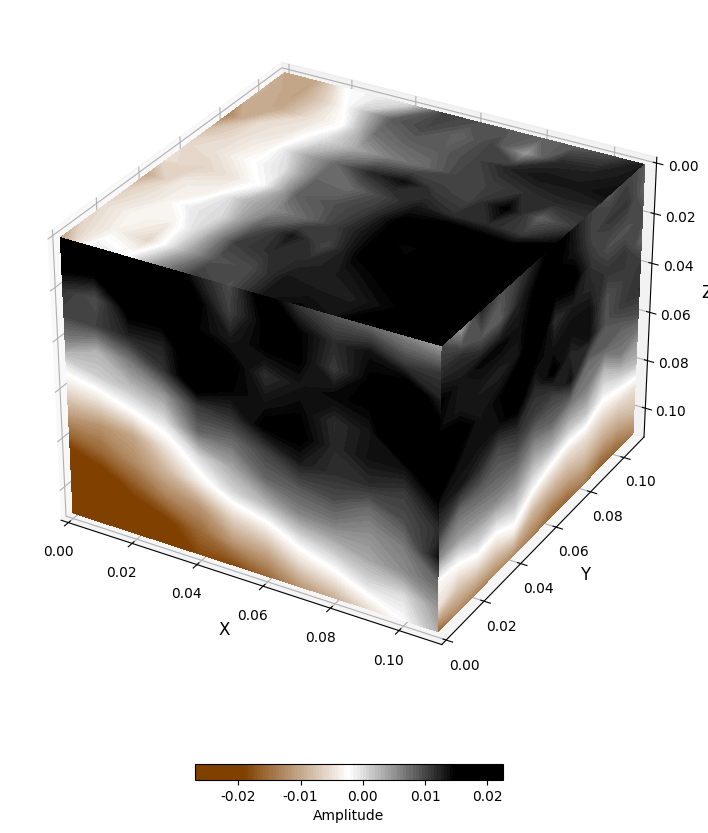

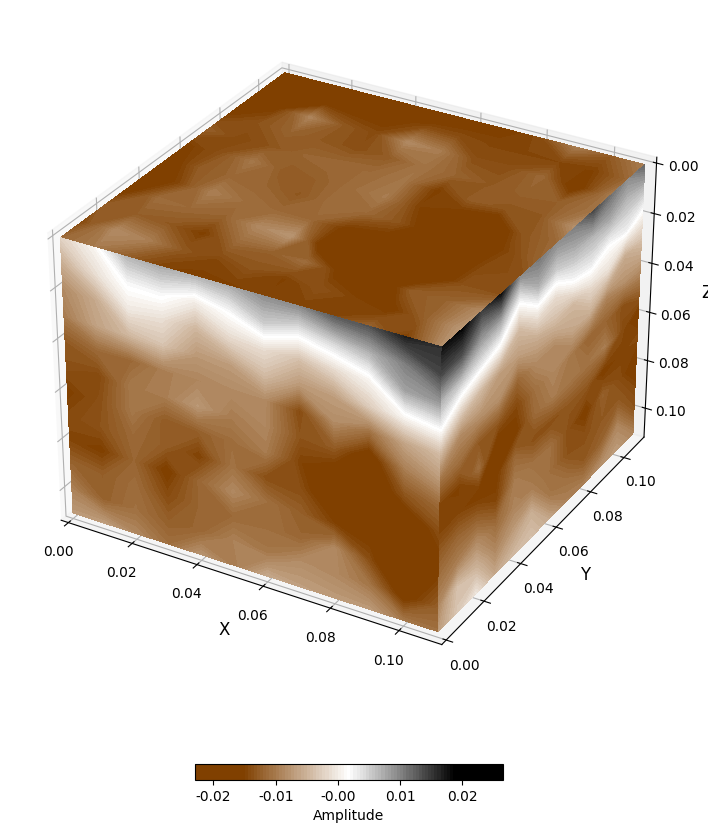

...

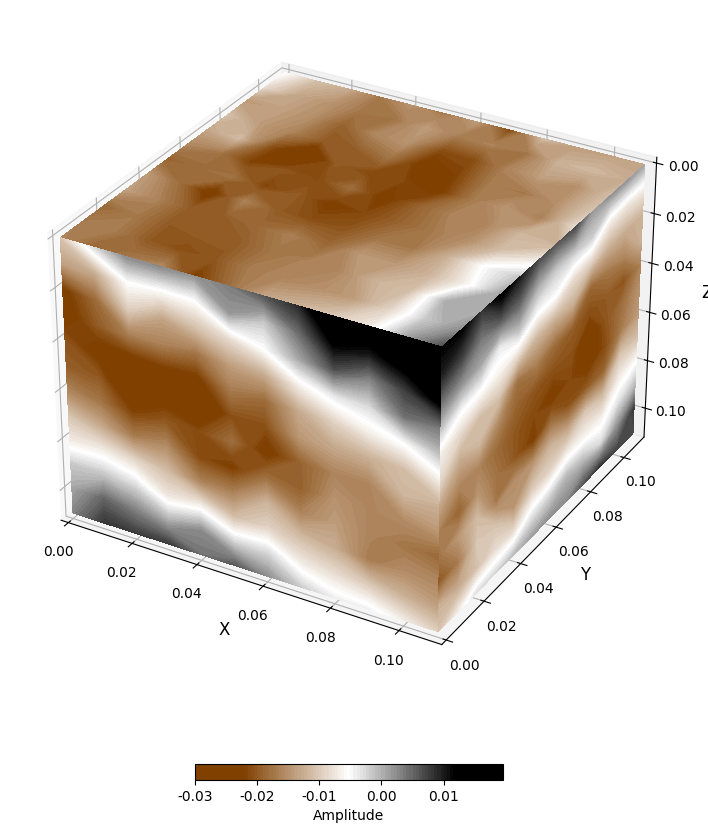

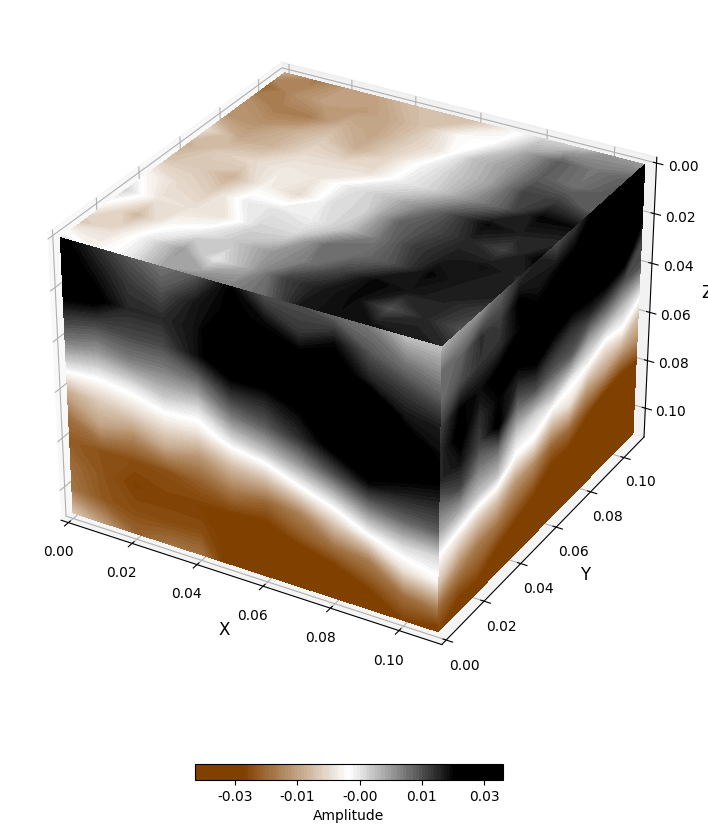

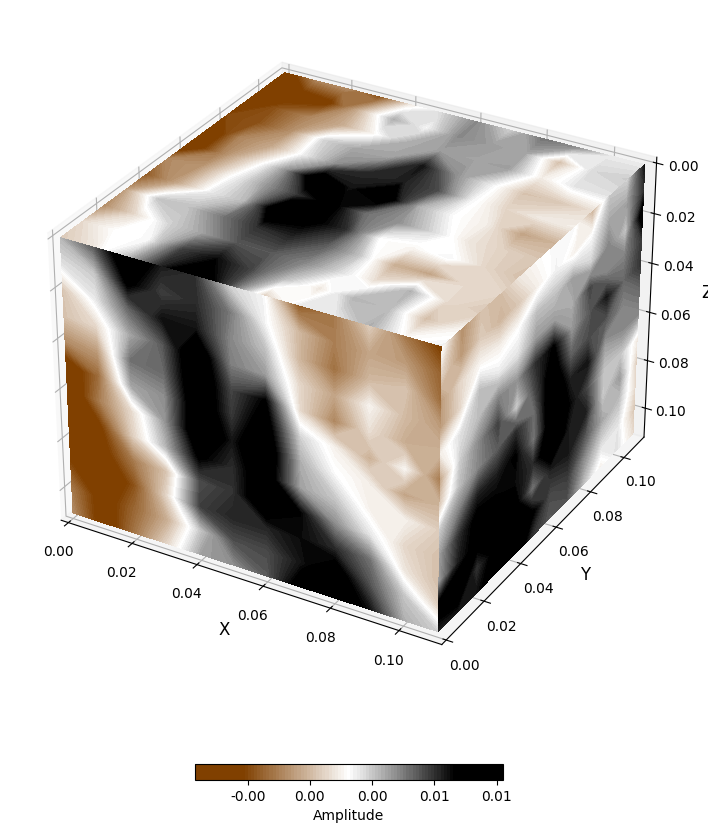

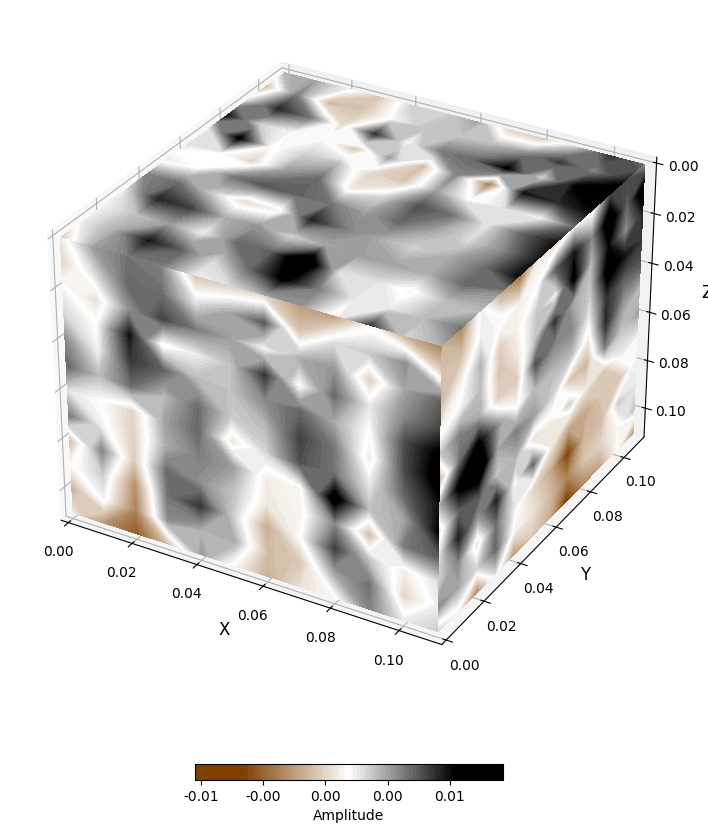

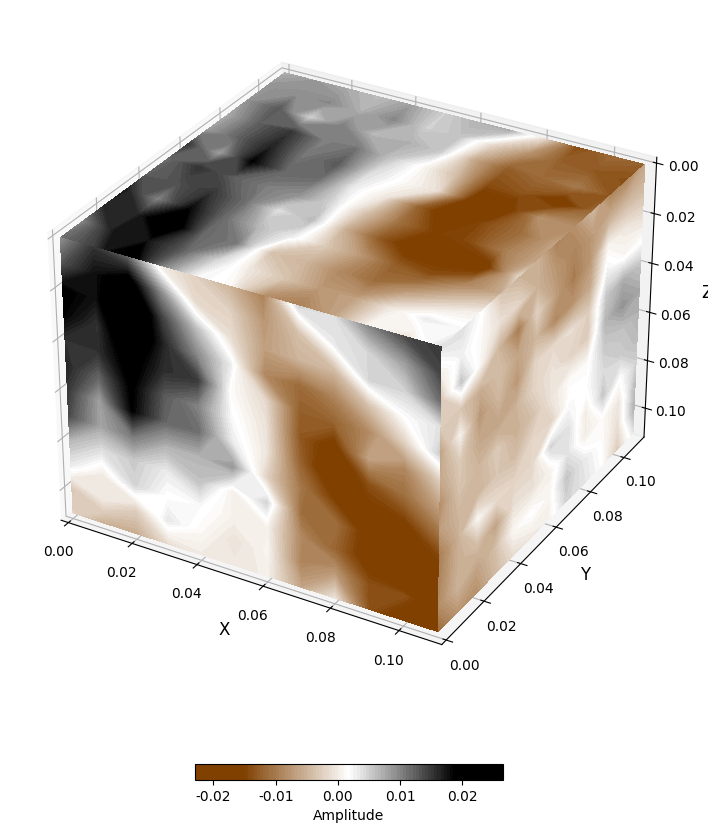

In [15]:
for ii in range(64):
    data=W2[ii,:].reshape(12,12,12)
    plot3d(data,figsize=(16,10),cmap=cseis(),barlabel='Amplitude',showf=True,close=False)

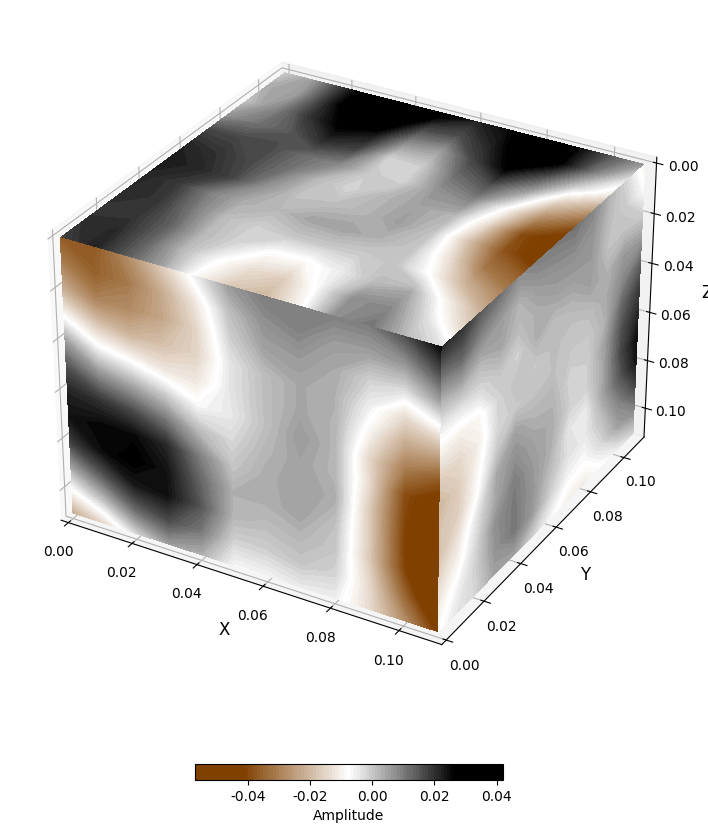

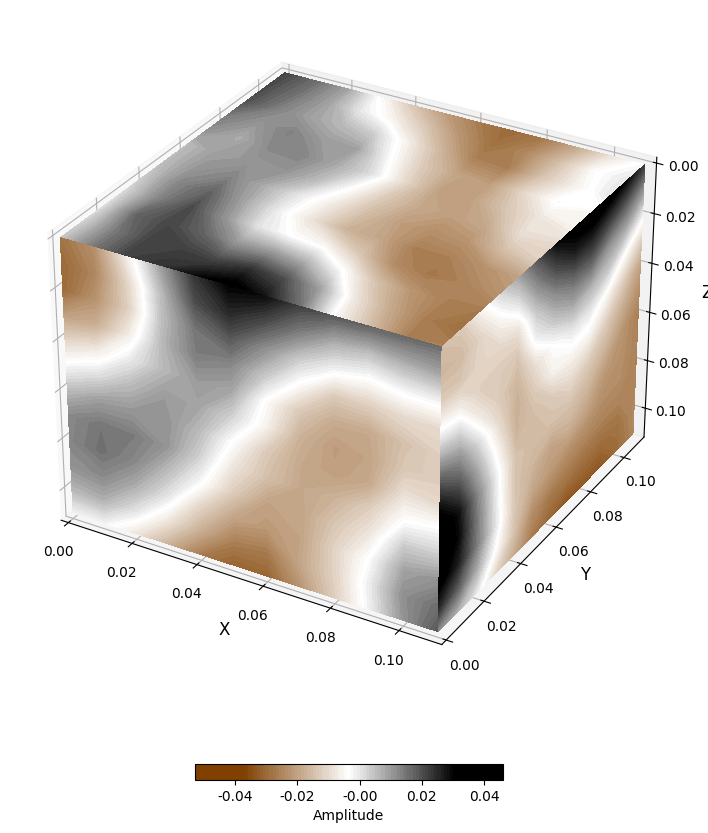

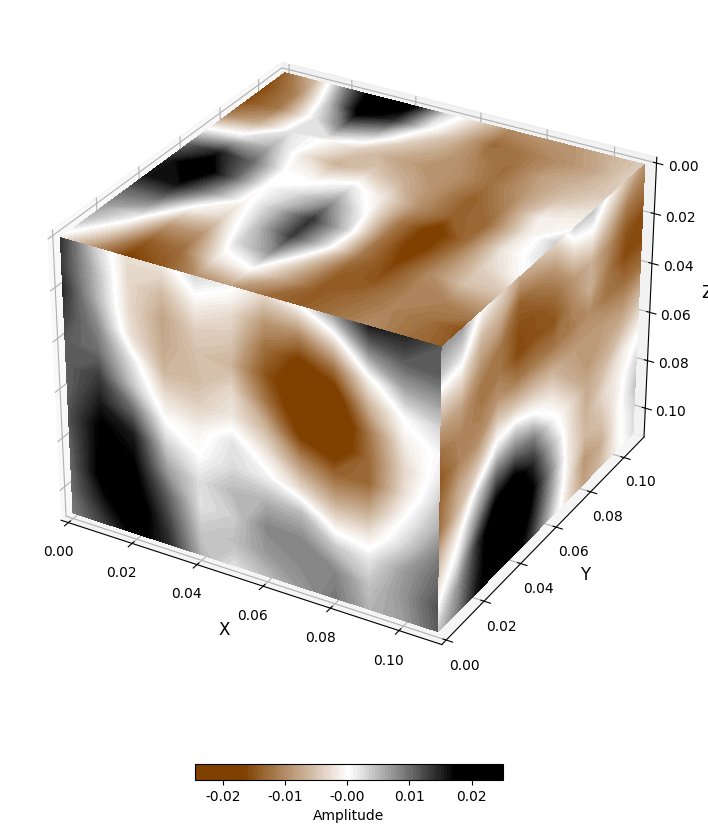

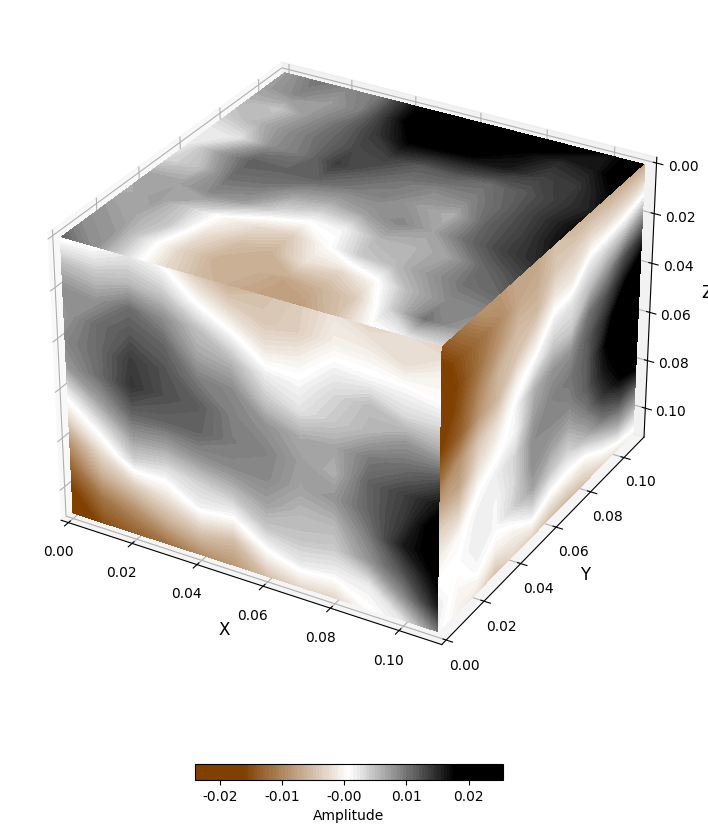

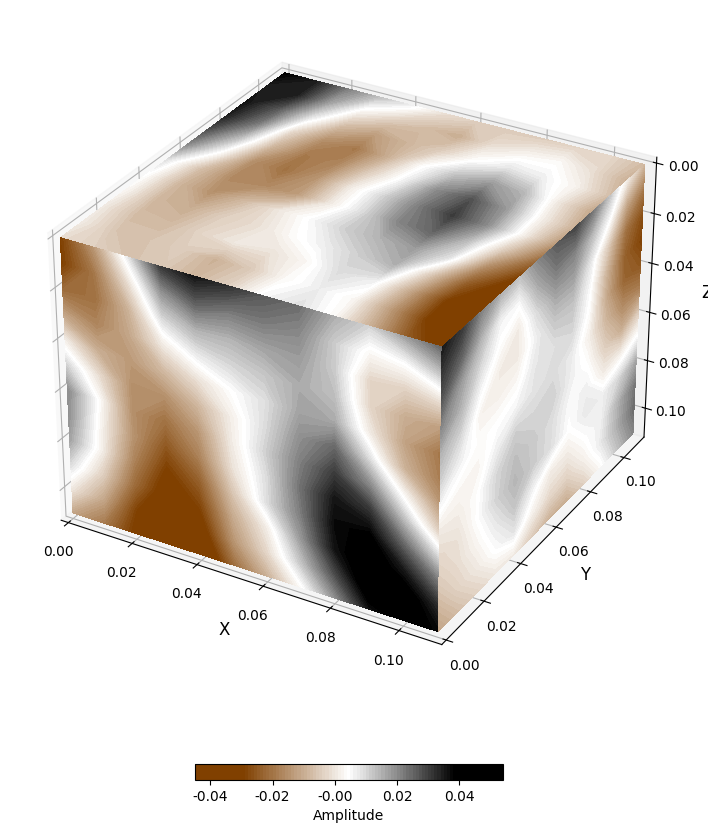

...

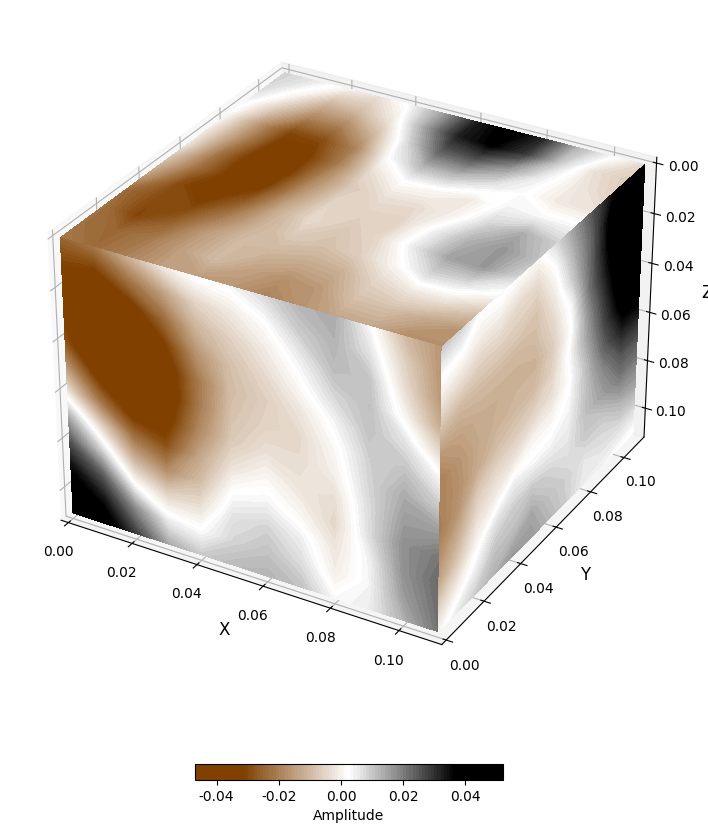

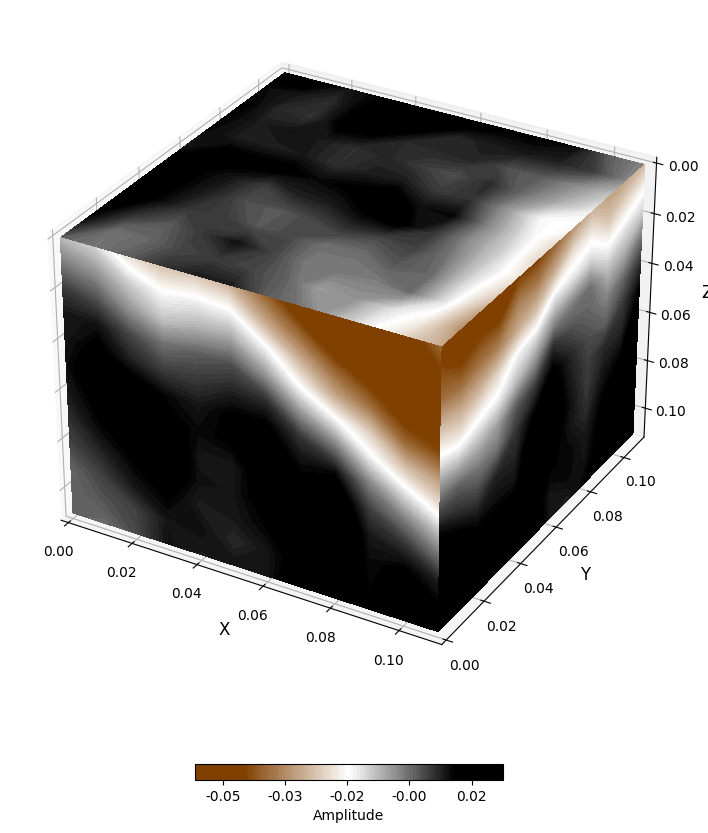

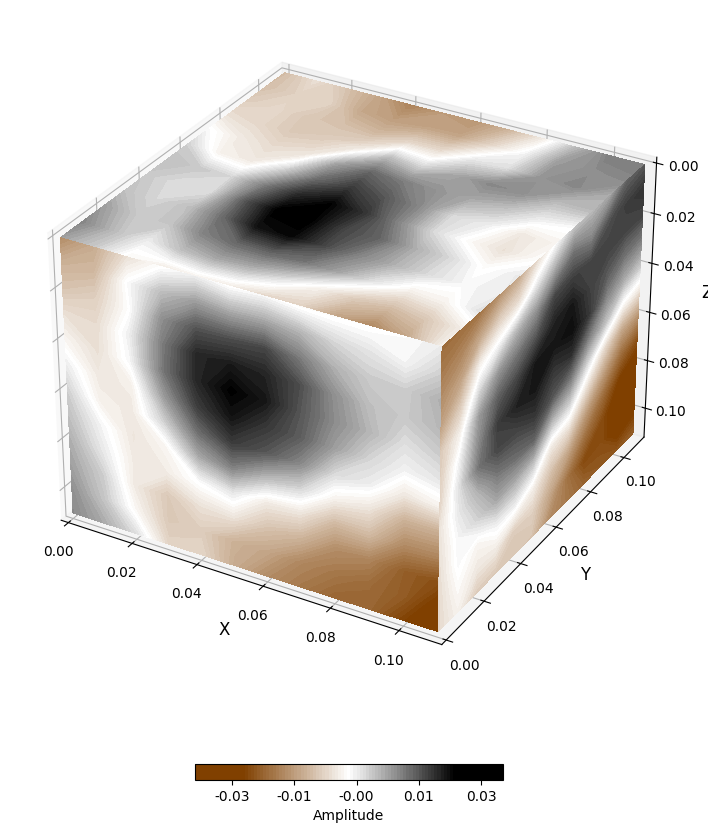

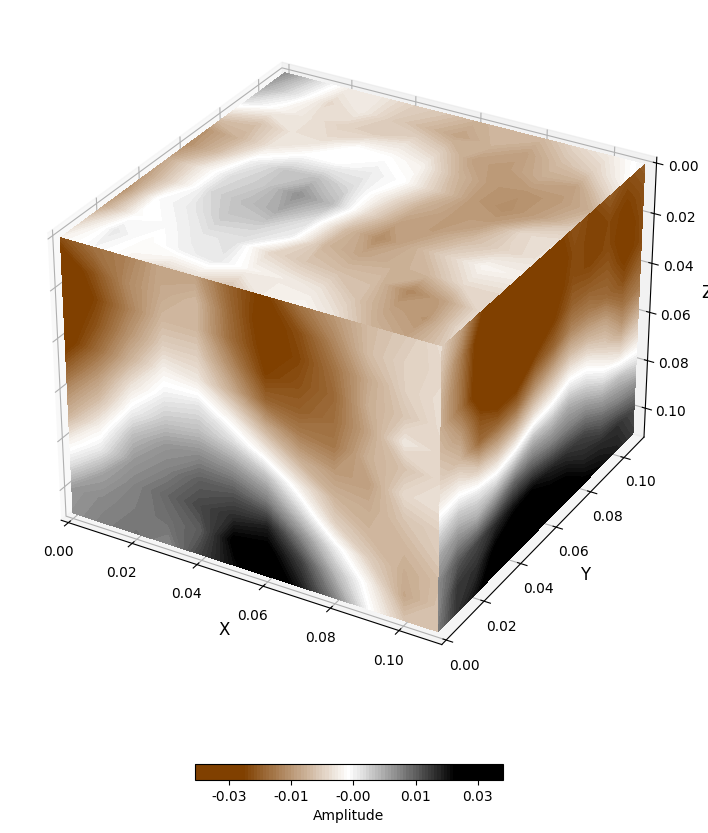

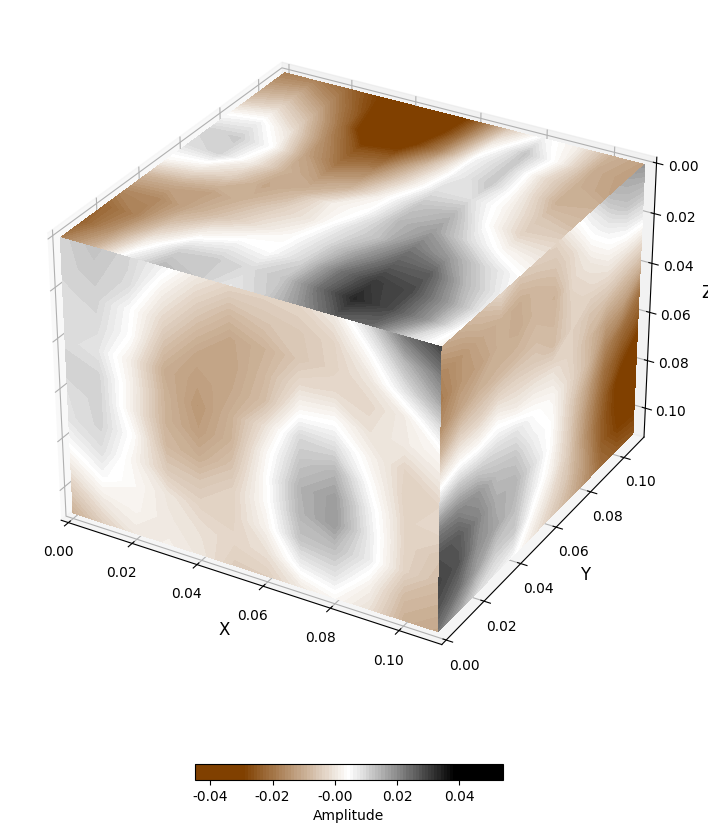

In [16]:
for ii in range(64):
    data=W2[64+ii,:].reshape(12,12,12)
    plot3d(data,figsize=(16,10),cmap=cseis(),barlabel='Amplitude',showf=True,close=False)